<table style="border:none; border-collapse:collapse; cellspacing:0; cellpadding:0">
    <tr>
        <td width=30% style="border:none">
            <img src="logo_datascientest.png" width="100%"/>
        </td>
        <td style="border:none">
            <center>
                <h1>DS project: Customer satisfaction</h1>
                <h2>Topic Modeling - BERTopic</h2>
            </center>
        </td>
    </tr>
</table>

<hr>

**Date** : 2023

**Author** : Elie MAZE, Luc Thomas

**Goal** : Trouver les topics à partir d'avis de clients et estimer comment ils sont liés à des sujets de mécontentements ou  de satisfaction.

In [75]:
import _mypath
import os
import pandas as pd
import numpy as np
from threadpoolctl import threadpool_limits

from bertopic import BERTopic
from bertopic.vectorizers import ClassTfidfTransformer

from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn import manifold

from random import choice
from pprint import pprint

import nltk
nltk.data.path.append("/data/DATALAB_PAU/18_HPC/nltk_data")

from nltk.corpus import stopwords
from sklearn.metrics.pairwise import cosine_similarity

from threadpoolctl import threadpool_limits

import torch
from transformers import FlaubertModel, FlaubertTokenizer, CamembertTokenizer, CamembertModel

from training.predict import encode_inputs, getEmbeddings, getTextsEmbeddings
from data.processing import plot_word_cloud
from visu.visu import plotVectors

import gc

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

%load_ext autoreload
%autoreload 1

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import bokeh.io
bokeh.io.output_notebook()

Loading BokehJS ...

In [3]:
import bokeh.plotting as bpl
bpl.output_notebook()

Loading BokehJS ...

In [42]:
SETS = [str(i) for i in range(1,6)]
MARKERS = ['square', 'circle', 'asterisk', 'triangle', 'diamond']

In [40]:
stop_words = stopwords.words('french')

In [43]:
os.environ["CUDA_VISIBLE_DEVICES"]="15"
os.environ["LD_LIBRARY_PATH"]="/data/appli_PITSI/HGX2//nvidia/cuda/install/cuda_11.2.1/lib64/:/data/appli_PITSI/HGX2/nvidia/cuda/install/cuda_11.2.1_compat/lib64:/data/appli_PITSI/HGX2/nvidia/cudnn/install/cudnn-11.2-linux-x64-v8.1.1.33/lib64"

In [44]:
# selecting a GPU with PyTorch (choose a free GPU!) 
GPU_NUMBER=15

# setting device on GPU if available, else CPU
device = torch.device("cuda:{0}".format(GPU_NUMBER) if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available():
    print("__Used Logical Devices: {0}".format(device))
    print("__CUDNN VERSION:", torch.backends.cudnn.version())
    print("__Device Name:",torch.cuda.get_device_name(GPU_NUMBER))
    print("__Device Total Memory: {} GB".format(round(torch.cuda.get_device_properties(device).total_memory/1024**3,1)))
    print("__Memory Usage: Allocated {0} GB, Cached {1} GB".format(
        round(torch.cuda.memory_allocated(device)/1024**3,1), 
        round(torch.torch.cuda.memory_reserved(device)/1024**3,1)))

__Used Logical Devices: cuda:15
__CUDNN VERSION: 8101
__Device Name: Tesla V100-SXM3-32GB
__Device Total Memory: 31.7 GB
__Memory Usage: Allocated 0.0 GB, Cached 0.5 GB


# Data loading

In [45]:
PRJ_FOLDER = "/data/DATALAB_PAU/20_projects/j0215602/DS_NLP"
#PRJ_FOLDER = r"D:\DevPy\DS_NLP"

DATA_FOLDER = os.path.join(PRJ_FOLDER, "input", "processed")
RAW_MODEL_FOLDER = os.path.join(PRJ_FOLDER, "models")

_MAX_WORKERS = 8

In [46]:
infile = os.path.join(DATA_FOLDER, "processed_dataset.csv")
df = pd.read_csv(infile, sep=",", encoding="utf-8", engine="python")

print("data set:", df.shape)

data set: (105511, 11)


In [10]:
df.head(5)

,Commentaire,star,date,client,reponse,source,company,langage,cleaned_words,cleaned_lemma,Sentiment
0,"Colis commandé mardi 28 fevrier 23 , livraiso...",1,2023-03-07,Toto,NaN,TrustPilot,Amazon,fr,colis commandé mardi fevrier livraison jeu...,colis commander mardi fevrier livraison je...,__label__NEGATIVE
1,Amazon avec sa politique de retour est la pire...,1,2023-03-07,nasri eddine,NaN,TrustPilot,Amazon,fr,amazon politique pire contrairement ...,amazon politique pire contrairement ...,__label__NEGATIVE
2,Dieu sait que j'en connais des déboires avec l...,4,2023-03-07,Amandine,NaN,TrustPilot,Amazon,fr,dieu connais déboires sites marchands ...,dieu connaître déboire site marchand a...,__label__POSITIVE
3,"Nul, preleve une commande que je n'ai jamais r...",1,2023-03-07,Bob Brico,NaN,TrustPilot,Amazon,fr,preleve commande jamais reçu service cl...,prelev commande jamais recevoir service...,__label__NEGATIVE
4,Colis soit disant livré mais jamais reçu donc ...,1,2023-03-06,Client,NaN,TrustPilot,Amazon,fr,colis disant livré jamais reçu perdu non re...,colis dire livrer jamais recevoir perdre no...,__label__NEGATIVE


<AxesSubplot:>

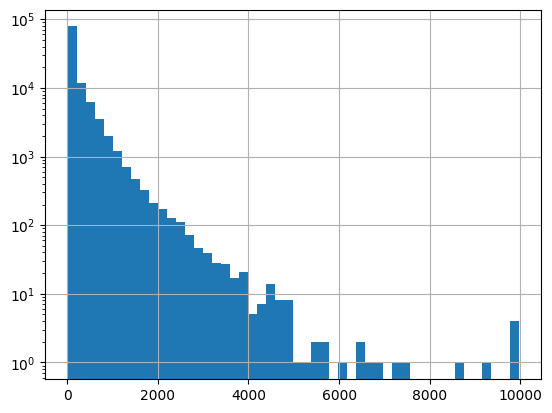

In [47]:
df["Commentaire"].str.len().hist(bins=50, log=True)

In [17]:
threshold = 40
mask_comments = (df["Commentaire"].str.strip().str.len()>threshold)
print(f"ratio of comments longer than {threshold:d} characters: {100*mask_comments.sum() / df.shape[0]:.2f}")

ratio of comments longer than 40 characters: 80.49


In [18]:
SAMPLE_NB = 2000
print("samples per star:", SAMPLE_NB)

tmp = pd.DataFrame(df[mask_comments])

samples = []

for star in range(1,6):
    satisfaction = "negative"
    if star==3:
        satisfaction = "neutral"
    elif star>3:
        satisfaction = "positive"
        
    mask = (tmp["star"]==star)
    sample = tmp.loc[mask, ["Commentaire", "cleaned_words", "cleaned_lemma", "star"]].sample(n=SAMPLE_NB)
    sample["satisfaction"] = satisfaction
    samples += [sample]

samples = pd.concat(samples)
samples = samples.reset_index(drop=True)

print("Samples:", samples.shape)
samples.head(5)

samples per star: 2000
Samples: (10000, 5)


,Commentaire,cleaned_words,cleaned_lemma,star,satisfaction
0,livraison 24h facturé 8euro receptionné en 5 j...,livraison 24h facturé 8euro receptionné jour...,livraison 24h facturer 8euro receptionné jou...,1,negative
1,"votre assistant sois disant là pour aider, il ...",assistant sois disant aider sert rien ...,assistant être dire aider servir rien ...,1,negative
2,"ce sont de gros charlatent. Je commande, je pa...",gros charlatent commande paie reçois ri...,gros charlatent commande payer recevoir...,1,negative
3,Après avoir commandé un samsung galaxy A50 le ...,commandé samsung galaxy a50 2/10 devait l...,commander samsung galaxy a50 2/10 devoir ...,1,negative
4,Amazone: Un catalogue web conçu par une équipe...,amazone catalogue web conçu équipe incapa...,amazone catalogue web concevoir équipe in...,1,negative


In [48]:
reviews = samples["Commentaire"].tolist()
cleaned_reviews = samples["cleaned_words"].tolist()
lemma_reviews = samples["cleaned_lemma"].tolist()

print("reviews:", len(reviews), end="\n\n")
print(reviews[10], end="\n\n")

print("lemmas:")
print(lemma_reviews[10])

reviews: 10000

j'ai commané un canapé a 419 €, et pris carte floabank pour obtenir une remise proposée de 105 €. la livraison n' a pas été effectuée, j'ai appelé et demander a changer d'adresse, au premier abord pas de probleme. puis Cdiscount a pretexté une rupture de stock alors que le canapé etait chez le transporteur. cdiscount a pretexté un defaut sur le canapé et a annulé la commande. ils m'ont propose une remboursement de 265 € et 49 € de bons d'achsts  alors que j'avais payé 315€ d . apres multiples appels au service clients, ils me propose de me rembourser 315 € . donc au final : 1 heure au telephone, je n'ai pas le canapé et etb je paye une carte floabank 15 €/ an pour rien !!!

lemmas:
commaner  canapé      prendre carte floabank  obtenir  remise proposer      livraison     être effectuer    appeler  demander  changer  adresse       probleme   cdiscount  pretexter  rupture  stock    canapé    transporteur  cdiscount  pretexter  defaut   canapé   annuler  commande     propos

# BERTopic - pretrained CamemBERT - sentence transformer
## Data preparation

In [20]:
MODEL_FOLDER = os.path.join(RAW_MODEL_FOLDER, "sentence-camembert-base")

sentence_model = SentenceTransformer(MODEL_FOLDER).to(device)

In [21]:
embeddings = sentence_model.encode(reviews, show_progress_bar=True, normalize_embeddings=True)
print("embeddings shape:", embeddings.shape)

Batches: 100%|██████████| 313/313 [00:13<00:00, 23.21it/s]

embeddings shape: (10000, 768)


In [22]:
OUT_EMBEDDINGS = os.path.join(DATA_FOLDER, "sentences_embeddings.npy")
np.save(OUT_EMBEDDINGS, embeddings)

## Dim Reduction & simple visu

In [23]:
stars = samples["star"].astype(str).tolist()
targets = samples["star"].tolist()

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SETS, markers=MARKERS, figsize=(900, 600), method="tsne")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


## BERTopic - Training

In [34]:
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
topic_model = BERTopic(ctfidf_model=ctfidf_model, n_gram_range=(1,3), min_topic_size=3, nr_topics=10)

In [35]:
with threadpool_limits(limits=_MAX_WORKERS):
    
    topics, probs = topic_model.fit_transform(lemma_reviews, embeddings)

    samples["topic_sentences"] = topics
    print("topic range:", min(topics), "to", max(topics))

topic range: -1 to 8


## Topic Information

In [36]:
topic_information = topic_model.get_topic_info()
topic_information

,Topic,Count,Name
0,-1,4261,-1_commande_client_livraison_site
1,0,3801,0_cdiscount_commande_livraison_client
2,1,1780,1_rapide_satisfaire_choix_bon
3,2,74,2_attendre_attendre livraison_attendre recevoi...
4,3,56,3_amliorer_amlioration_site bon_manque choix
5,4,13,4_commende_passer commende_virement_14032020
6,5,4,5_nickel cdiscount topefficacit_topefficacit r...
7,6,4,6_toujour_20avril_livre depuit 20avril_termineje
8,7,4,7_travailler bon fter_masquer bon comprehensio...
9,8,3,8_vouloir informer site_informer site votrelit...


In [37]:
topic_model.visualize_barchart()

In [38]:
topic_model.visualize_topics()

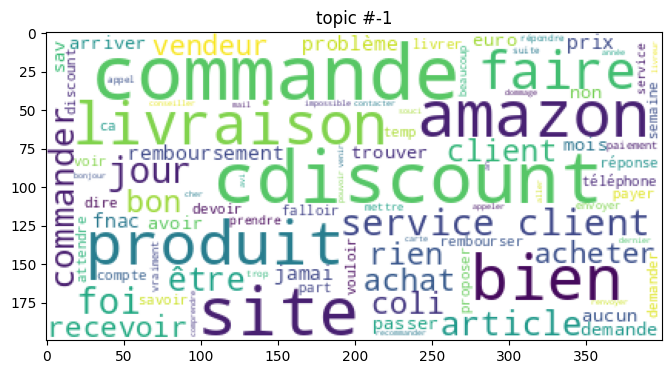

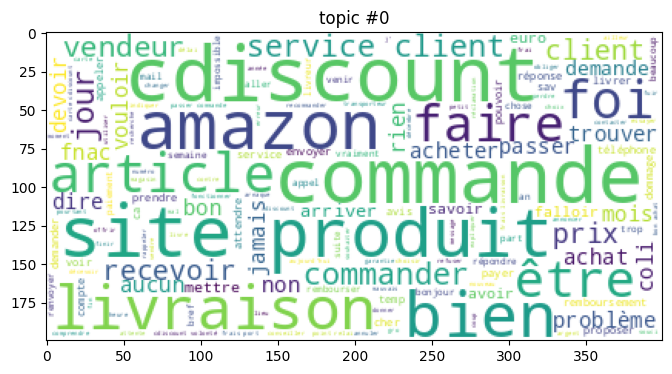

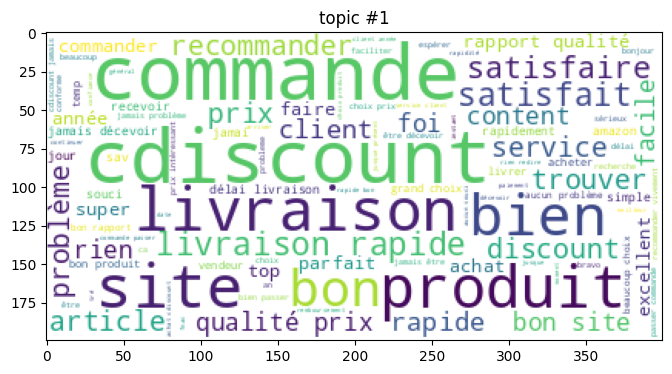

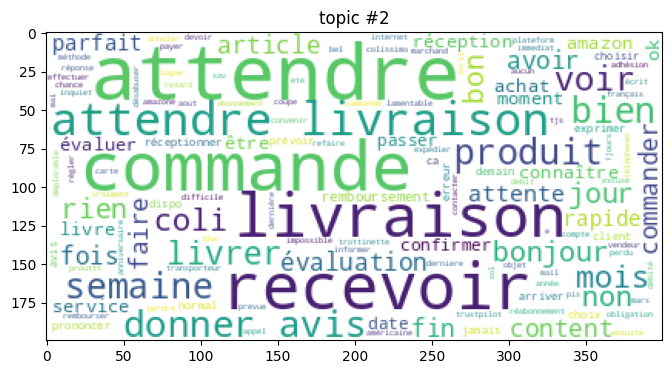

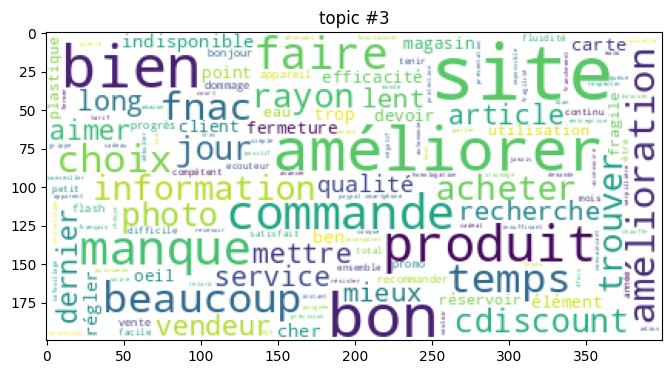

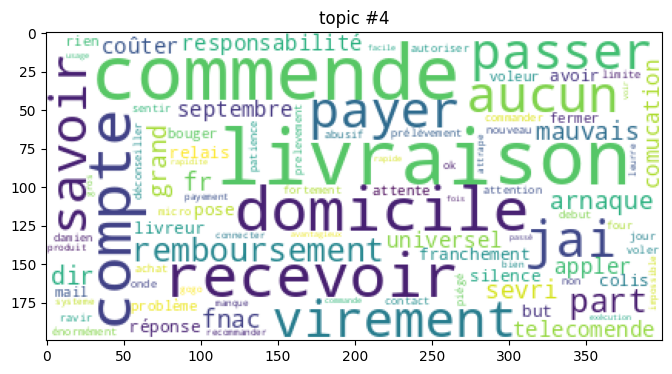

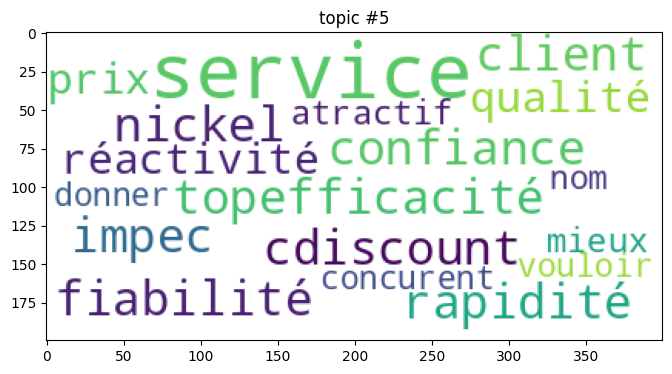

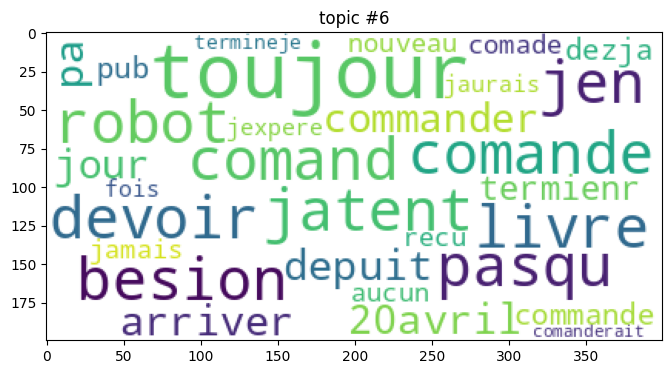

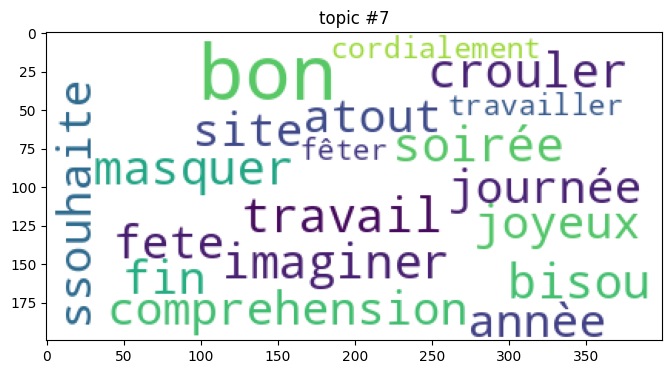

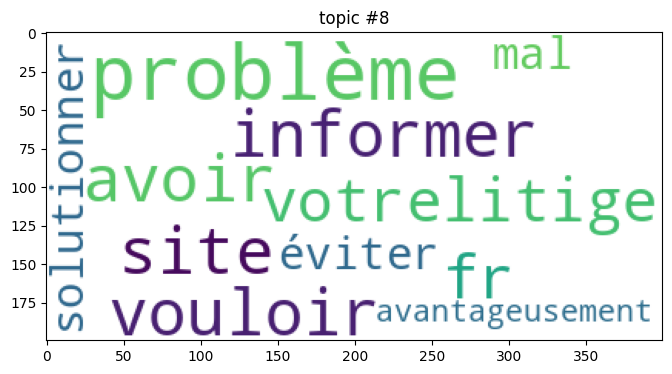

In [51]:
for topic in topic_information["Topic"].values:
    mask = (samples["topic_sentences"]==topic)
    text = " ".join(samples.loc[mask, "cleaned_lemma"].tolist())
    plot_word_cloud(text, "topic #"+str(topic), stop_words,color='white', max_words=200, figsize=(8, 4))

In [52]:
stars = samples["topic_sentences"].astype(str).tolist()
targets = samples["topic_sentences"].tolist()

SET_TOPICS = [str(i) for i in range(samples["topic_sentences"].min(), samples["topic_sentences"].max()+1)]
MARKERS_TOPICS = ['square', 'circle', 'asterisk', 'triangle', 'diamond', "cross", "dash", "star", "plus", "hex"]

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SET_TOPICS, markers=MARKERS_TOPICS, figsize=(900, 600), method="tsne")

## Test

In [53]:
index = choice(range(0, samples.shape[0]-1))

text, star = samples[["Commentaire", "star"]].values[index]
print("star:", star, end="\n\n")
print(text, end="\n\n")

preds, probs = topic_model.transform([text], embeddings[index].reshape(1,-1))

top_topic = preds[0]
print("topic #", top_topic, end="\n\n")

pprint(topic_model.get_topic(top_topic))

star: 5

très bien je suis très heureux de vos services

topic # 1

[('rapide', 0.3777299644870111),
 ('satisfaire', 0.33875881475626346),
 ('choix', 0.3326373447455238),
 ('bon', 0.33142309441646484),
 ('satisfait', 0.32866808563836697),
 ('prix', 0.32733711284021005),
 ('recommander', 0.3117032592335597),
 ('livraison rapide', 0.3116419698824498),
 ('livraison', 0.31162375064786274),
 ('cdiscount', 0.3105385377537093)]


# BERTopic - pretrained FlauBERT
## Data preparation

In [54]:
if torch.cuda.is_available():
    print("__Used Logical Devices: {0}".format(device))
    print("__CUDNN VERSION:", torch.backends.cudnn.version())
    print("__Device Name:",torch.cuda.get_device_name(GPU_NUMBER))
    print("__Device Total Memory: {} GB".format(round(torch.cuda.get_device_properties(device).total_memory/1024**3,1)))
    print("__Memory Usage: Allocated {0} GB, Cached {1} GB".format(
        round(torch.cuda.memory_allocated(device)/1024**3,1), 
        round(torch.torch.cuda.memory_reserved(device)/1024**3,1)))

__Used Logical Devices: cuda:15
__CUDNN VERSION: 8101
__Device Name: Tesla V100-SXM3-32GB
__Device Total Memory: 31.7 GB
__Memory Usage: Allocated 0.0 GB, Cached 0.5 GB


In [55]:
MODEL_PATH = os.path.join(RAW_MODEL_FOLDER, "flaubert-base-uncased")

tokenizer = FlaubertTokenizer.from_pretrained(MODEL_PATH)
flaubert_model = FlaubertModel.from_pretrained(MODEL_PATH).to(device)

Some weights of the model checkpoint at /data/DATALAB_PAU/20_projects/j0215602/DS_NLP/models/flaubert-base-uncased were not used when initializing FlaubertModel: ['pred_layer.proj.bias', 'pred_layer.proj.weight']
- This IS expected if you are initializing FlaubertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing FlaubertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [56]:
embeddings = getTextsEmbeddings(reviews, tokenizer, flaubert_model, device, batch_size=32, mean=True)
print("embeddings shape:", embeddings.shape)

100%|██████████| 313/313 [00:30<00:00, 10.31it/s]

embeddings shape: (10000, 768)


In [57]:
OUT_EMBEDDINGS = os.path.join(DATA_FOLDER, "flaubert_pretrained_embeddings.npy")
np.save(OUT_EMBEDDINGS, embeddings)

## Dim Reduction & simple visu

In [59]:
stars = samples["star"].astype(str).tolist()
targets = samples["star"].tolist()

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SETS, markers=MARKERS, figsize=(900, 600), method="tsne")

## BERTopic - Training

In [60]:
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
topic_model = BERTopic(ctfidf_model=ctfidf_model, n_gram_range=(1,3), min_topic_size=3, nr_topics=10)

In [62]:
with threadpool_limits(limits=_MAX_WORKERS):
    
    topics, probs = topic_model.fit_transform(lemma_reviews, embeddings)

    samples["topic_flaubert"] = topics
    print("topic range:", min(topics), "to", max(topics))

topic range: 0 to 3


## Topic Information

In [63]:
topic_information = topic_model.get_topic_info()
topic_information

,Topic,Count,Name
0,0,13,0_bien passer_bien passer recommander_passer r...
1,1,5986,1_commande_cdiscount_client_livraison
2,2,1223,2_commande_site_livraison_cdiscount
3,3,2778,3_livraison_bon_commande_prix


In [64]:
topic_model.visualize_barchart()

In [65]:
topic_model.visualize_topics()

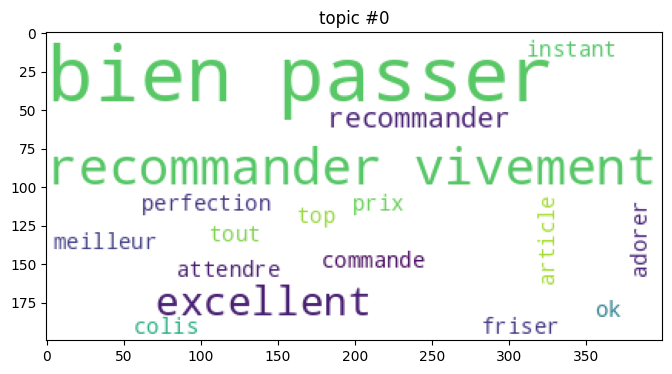

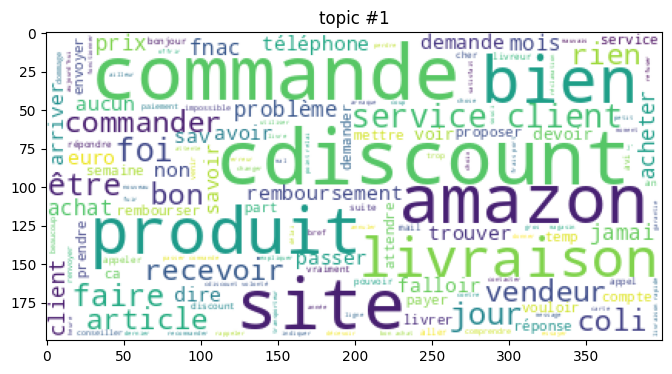

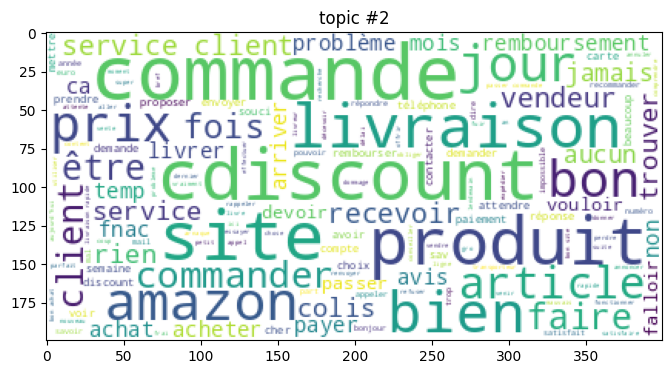

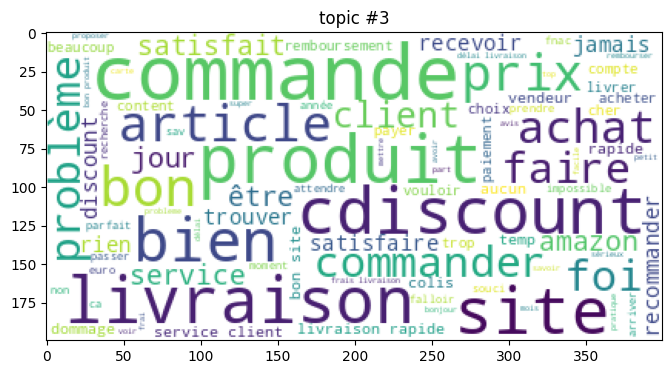

In [66]:
for topic in topic_information["Topic"].values:
    mask = (samples["topic_flaubert"]==topic)
    text = " ".join(samples.loc[mask, "cleaned_lemma"].tolist())
    plot_word_cloud(text, "topic #"+str(topic), stop_words,color='white', max_words=200, figsize=(8, 4))

In [67]:
stars = samples["topic_flaubert"].astype(str).tolist()
targets = samples["topic_flaubert"].tolist()

SET_TOPICS = [str(i) for i in range(samples["topic_flaubert"].min(), samples["topic_flaubert"].max()+1)]
MARKERS_TOPICS = ['square', 'circle', 'asterisk', 'triangle', 'diamond', "cross", "dash", "star", "plus", "hex"]

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SET_TOPICS, markers=MARKERS_TOPICS, figsize=(900, 600), method="tsne")

In [71]:
#index = choice(range(0, samples.shape[0]-1))

print("index:", index)
text, star = samples[["Commentaire", "star"]].values[index]
print("star:", star, end="\n\n")
print(text, end="\n\n")

preds, probs = topic_model.transform([text], embeddings[index].reshape(1,-1))

top_topic = preds[0]
print("topic #", top_topic, end="\n\n")

pprint(topic_model.get_topic(top_topic))

index: 8878
star: 5

très bien je suis très heureux de vos services

topic # 3

[('livraison', 0.3764927652573101),
 ('bon', 0.34295199221636163),
 ('commande', 0.3272348052254968),
 ('prix', 0.32185154509488456),
 ('site', 0.3212018629665768),
 ('produit', 0.31822687921602427),
 ('rapide', 0.30008133835728124),
 ('cdiscount', 0.2929950107269028),
 ('bien', 0.2856447895602052),
 ('choix', 0.2758332502679072)]


# BERTopic - pretrained CamemBERT
## Data preparation

In [72]:
if torch.cuda.is_available():
    print("__Used Logical Devices: {0}".format(device))
    print("__CUDNN VERSION:", torch.backends.cudnn.version())
    print("__Device Name:",torch.cuda.get_device_name(GPU_NUMBER))
    print("__Device Total Memory: {} GB".format(round(torch.cuda.get_device_properties(device).total_memory/1024**3,1)))
    print("__Memory Usage: Allocated {0} GB, Cached {1} GB".format(
        round(torch.cuda.memory_allocated(device)/1024**3,1), 
        round(torch.torch.cuda.memory_reserved(device)/1024**3,1)))

__Used Logical Devices: cuda:15
__CUDNN VERSION: 8101
__Device Name: Tesla V100-SXM3-32GB
__Device Total Memory: 31.7 GB
__Memory Usage: Allocated 0.5 GB, Cached 5.7 GB


In [78]:
MODEL_PATH = os.path.join(RAW_MODEL_FOLDER, "camembert-base")

tokenizer = CamembertTokenizer.from_pretrained(MODEL_PATH)
camembert_model = CamembertModel.from_pretrained(MODEL_PATH).to(device)

Some weights of the model checkpoint at /data/DATALAB_PAU/20_projects/j0215602/DS_NLP/models/camembert-base were not used when initializing CamembertModel: ['lm_head.bias', 'lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.decoder.bias', 'lm_head.dense.bias']
- This IS expected if you are initializing CamembertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing CamembertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [79]:
embeddings = getTextsEmbeddings(reviews, tokenizer, camembert_model, device, batch_size=32, mean=True)
print("embeddings shape:", embeddings.shape)

100%|██████████| 313/313 [00:23<00:00, 13.15it/s]

embeddings shape: (10000, 768)


In [80]:
OUT_EMBEDDINGS = os.path.join(DATA_FOLDER, "camembert_pretrained_embeddings.npy")
np.save(OUT_EMBEDDINGS, embeddings)

## Dim Reduction & simple visu

In [81]:
stars = samples["star"].astype(str).tolist()
targets = samples["star"].tolist()

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SETS, markers=MARKERS, figsize=(900, 600), method="tsne")

## BERTopic - Training

In [82]:
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
topic_model = BERTopic(ctfidf_model=ctfidf_model, n_gram_range=(1,3), min_topic_size=3, nr_topics=10)

In [83]:
with threadpool_limits(limits=_MAX_WORKERS):
    
    topics, probs = topic_model.fit_transform(lemma_reviews, embeddings)

    samples["topic_camembert"] = topics
    print("topic range:", min(topics), "to", max(topics))

topic range: -1 to 8


## Topic Information

In [84]:
topic_information = topic_model.get_topic_info()
topic_information

,Topic,Count,Name
0,-1,79,-1_client annee_probleme_jour client_annee
1,0,9832,0_commande_livraison_cdiscount_site
2,1,41,1_probleme_client annee jamais_signalercommand...
3,2,11,2_livrefacilite commande bon_produit non dispo...
4,3,9,3_floabank_fois payer_payer fois_identifiant m...
5,4,8,4_livraison rencontre_evaluer produit objectif...
6,5,6,5_voir qualite livraison_chose faciliter paimm...
7,6,5,6_015_malgre maint appel_proposer mise panier_...
8,7,5,7_gratuite avedc carte_discount perimee renouv...
9,8,4,8_fois refregerateur frigo_marche delai passer...


In [85]:
topic_model.visualize_barchart()

In [86]:
topic_model.visualize_topics()

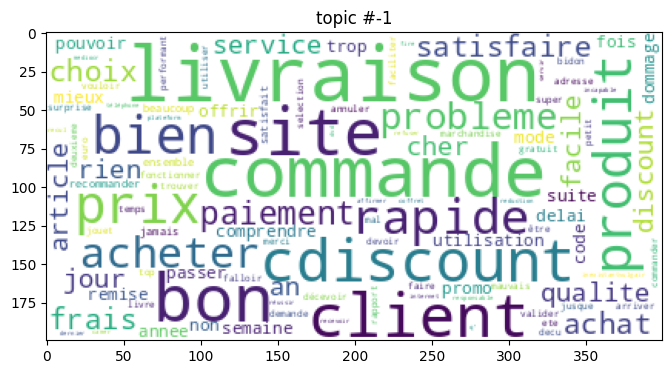

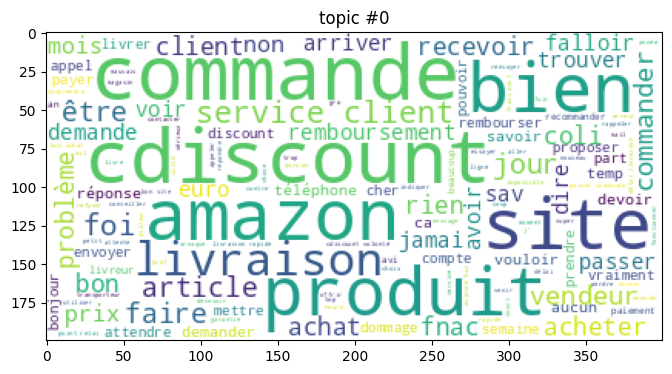

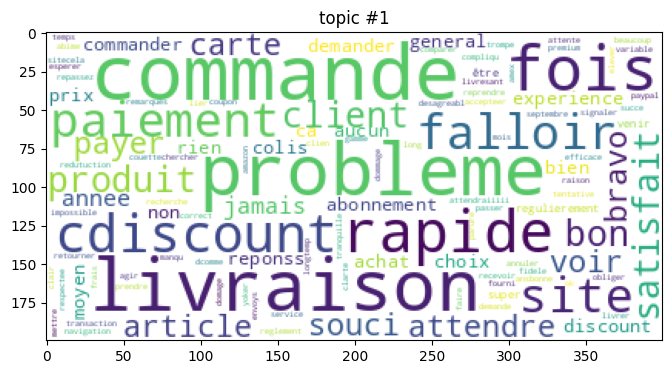

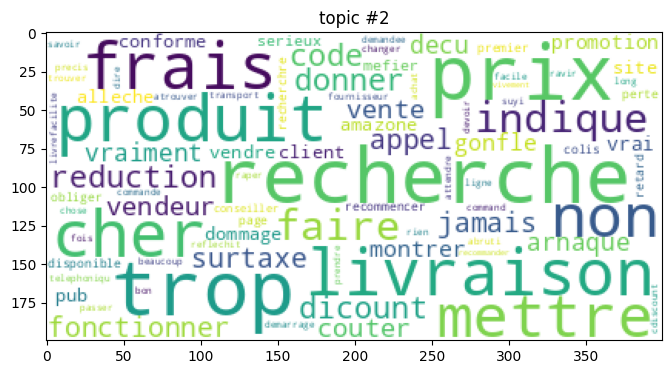

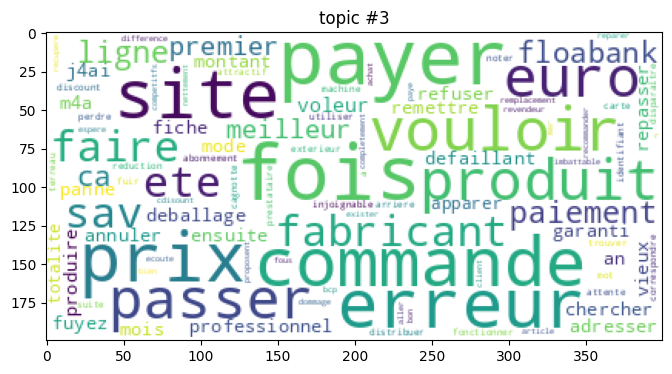

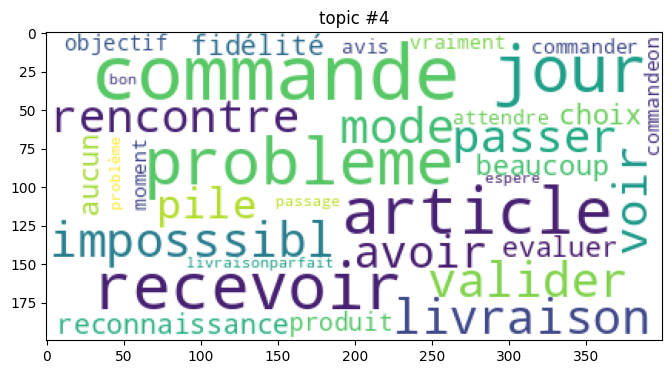

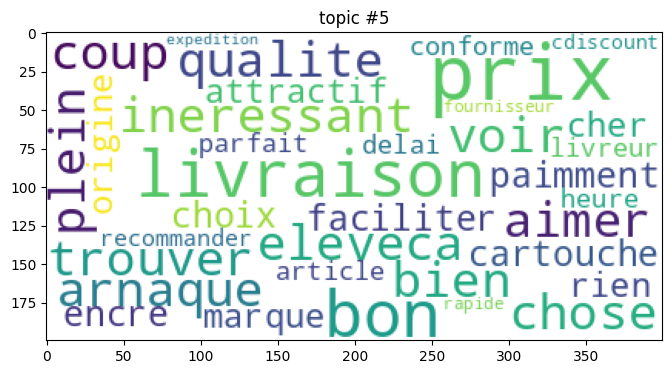

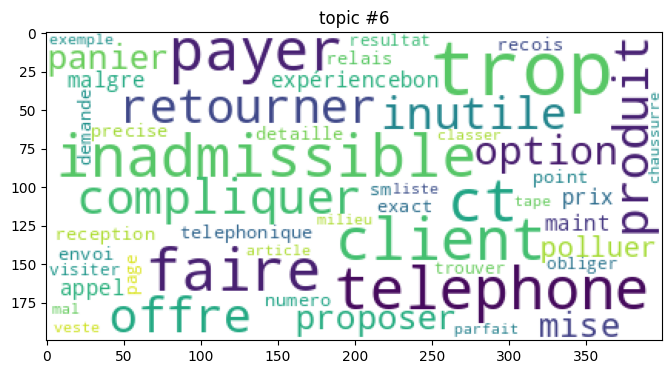

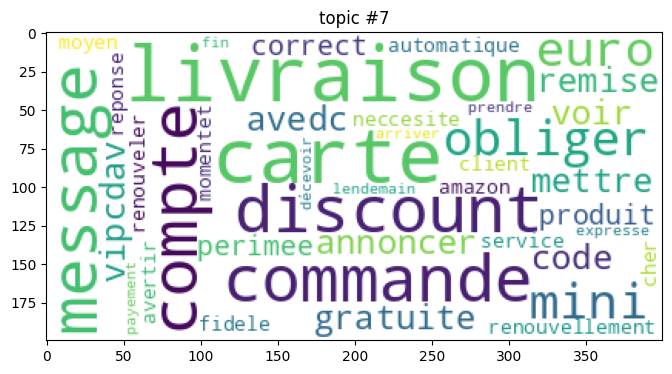

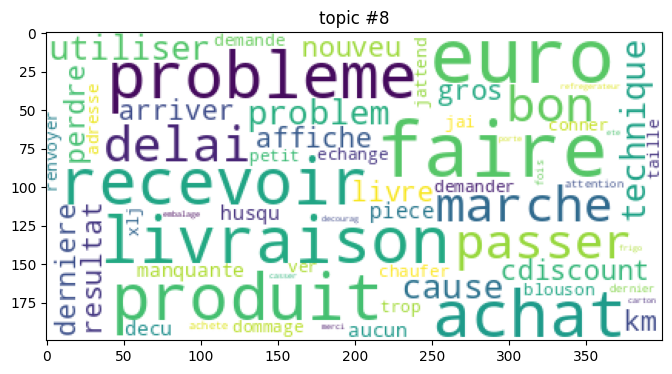

In [87]:
for topic in topic_information["Topic"].values:
    mask = (samples["topic_camembert"]==topic)
    text = " ".join(samples.loc[mask, "cleaned_lemma"].tolist())
    plot_word_cloud(text, "topic #"+str(topic), stop_words,color='white', max_words=200, figsize=(8, 4))

In [88]:
stars = samples["topic_camembert"].astype(str).tolist()
targets = samples["topic_camembert"].tolist()

SET_TOPICS = [str(i) for i in range(samples["topic_camembert"].min(), samples["topic_camembert"].max()+1)]
MARKERS_TOPICS = ['square', 'circle', 'asterisk', 'triangle', 'diamond', "cross", "dash", "star", "plus", "hex"]

plotVectors(embeddings, reviews, serie_values=stars, hue_value=targets, legend=SET_TOPICS, markers=MARKERS_TOPICS, figsize=(900, 600), method="tsne")

In [89]:
#index = choice(range(0, samples.shape[0]-1))

print("index:", index)
text, star = samples[["Commentaire", "star"]].values[index]
print("star:", star, end="\n\n")
print(text, end="\n\n")

preds, probs = topic_model.transform([text], embeddings[index].reshape(1,-1))

top_topic = preds[0]
print("topic #", top_topic, end="\n\n")

pprint(topic_model.get_topic(top_topic))

index: 8878
star: 5

très bien je suis très heureux de vos services

topic # 0

[('commande', 0.22348958375858222),
 ('livraison', 0.21447456427490422),
 ('cdiscount', 0.2138595237640434),
 ('site', 0.20933914475769735),
 ('client', 0.20534506198756247),
 ('produit', 0.20374227699074454),
 ('service', 0.20305010278599375),
 ('bien', 0.19437912242317623),
 ('tre', 0.19325708177466863),
 ('bon', 0.1928583066375681)]
